# Домашнее задание к лекции "Визуализация данных"

## Обязательная часть

Вам необходимо провести базовый [EDA](https://en.wikipedia.org/wiki/Exploratory_data_analysis) выбранного набора данных. 

Требования к анализу:
- построить не менее 4 визуализаций различных видов;
- каждая визуализация должным образом оформлена и читается даже в отрыве от контекста; 
- по каждой визуализации необходимо написать вывод (какую гипотезу на ее основе можно выдвинуть?).

**Откуда брать данные?**

Можете взять свои рабочие данные, либо найти открытые данные (например, на [kaggle.com](https://www.kaggle.com/)) по интересующей вас предметной области (тогда не забудьте их выложить на github вместе с ноутбуком). Если идей нет, можете взять один из перечисленных ниже:
- [данные приложений из Google Play](https://www.kaggle.com/lava18/google-play-store-apps);
- [данные о видео из трендов YouTube](https://www.kaggle.com/datasnaek/youtube-new);
- [данные об уровне счастья в разных странах](https://www.kaggle.com/unsdsn/world-happiness).


In [208]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
#увеличим дефолтный размер графиков
from pylab import rcParams
rcParams['figure.figsize'] = 13,6

In [209]:
apps = pd.read_csv('data/googleplaystore.csv')
apps['Installs'] = apps['Installs'].apply(lambda x : x.strip('+').replace(',', ''))
apps['Installs'] = pd.to_numeric(apps['Installs'], errors='coerce')
apps['Installs'] = apps['Installs'].astype('Int32')
apps['Rating'] = pd.to_numeric(apps['Rating'], errors='coerce')
apps['Reviews'] = pd.to_numeric(apps['Reviews'], errors='coerce')
apps['Price'] = pd.to_numeric(apps['Price'], errors='coerce')
apps['Last Updated'] =  pd.to_datetime(apps['Last Updated'], format='%B %d, %Y', errors='coerce')
apps

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
0,Photo Editor & Candy Camera & Grid & ScrapBook,ART_AND_DESIGN,4.1,159.0,19M,10000,Free,0.0,Everyone,Art & Design,2018-01-07,1.0.0,4.0.3 and up
1,Coloring book moana,ART_AND_DESIGN,3.9,967.0,14M,500000,Free,0.0,Everyone,Art & Design;Pretend Play,2018-01-15,2.0.0,4.0.3 and up
2,"U Launcher Lite – FREE Live Cool Themes, Hide ...",ART_AND_DESIGN,4.7,87510.0,8.7M,5000000,Free,0.0,Everyone,Art & Design,2018-08-01,1.2.4,4.0.3 and up
3,Sketch - Draw & Paint,ART_AND_DESIGN,4.5,215644.0,25M,50000000,Free,0.0,Teen,Art & Design,2018-06-08,Varies with device,4.2 and up
4,Pixel Draw - Number Art Coloring Book,ART_AND_DESIGN,4.3,967.0,2.8M,100000,Free,0.0,Everyone,Art & Design;Creativity,2018-06-20,1.1,4.4 and up
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10836,Sya9a Maroc - FR,FAMILY,4.5,38.0,53M,5000,Free,0.0,Everyone,Education,2017-07-25,1.48,4.1 and up
10837,Fr. Mike Schmitz Audio Teachings,FAMILY,5.0,4.0,3.6M,100,Free,0.0,Everyone,Education,2018-07-06,1.0,4.1 and up
10838,Parkinson Exercices FR,MEDICAL,NaN,3.0,9.5M,1000,Free,0.0,Everyone,Medical,2017-01-20,1.0,2.2 and up
10839,The SCP Foundation DB fr nn5n,BOOKS_AND_REFERENCE,4.5,114.0,Varies with device,1000,Free,0.0,Mature 17+,Books & Reference,2015-01-19,Varies with device,Varies with device


In [210]:
apps.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10841 entries, 0 to 10840
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   App             10841 non-null  object        
 1   Category        10841 non-null  object        
 2   Rating          9367 non-null   float64       
 3   Reviews         10840 non-null  float64       
 4   Size            10841 non-null  object        
 5   Installs        10840 non-null  Int32         
 6   Type            10840 non-null  object        
 7   Price           10040 non-null  float64       
 8   Content Rating  10840 non-null  object        
 9   Genres          10841 non-null  object        
 10  Last Updated    10840 non-null  datetime64[ns]
 11  Current Ver     10833 non-null  object        
 12  Android Ver     10838 non-null  object        
dtypes: Int32(1), datetime64[ns](1), float64(3), object(8)
memory usage: 1.0+ MB


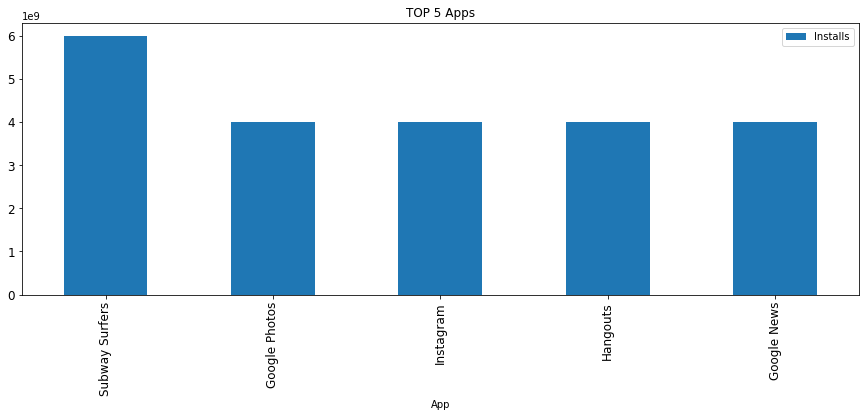

In [211]:
# 1. Топ 5 приложений с наибольшим количеством установок

top5_apps = apps[['App', 'Installs']].groupby(['App']).sum().sort_values(by = 'Installs', ascending = False).head(5)
top5_apps_plot = top5_apps.plot(kind='bar', title ="TOP 5 Apps", figsize=(15, 5), legend=True, fontsize=12)
# Вывод: В топ пять входят американские приложения с кол-вом установок более 4.000000e+09

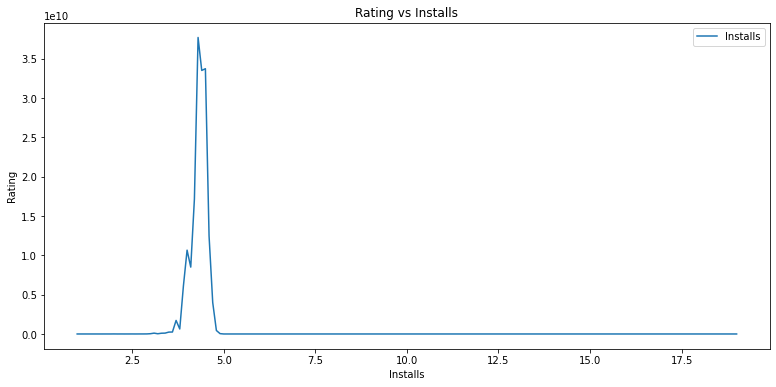

In [212]:
# 2. Динамика установок от рейтинга 

dynamics_by_rating = apps[['Rating', 'Installs']].groupby('Rating').sum()
ax = dynamics_by_rating.plot(kind='line', title ="Rating vs Installs", xlabel='Installs', ylabel='Rating')
# Вывод: Приложения с максимальным рейтингом имеют 3-5 млн. установок, максимальный рейтинг не гарантирует максимальное кол-во установок и наоборот максимальное кол-во установок не даёт максимальный рейтинг, значит пользователи не всегда смотрят на рейтинг прежде чем установить приложение.

<AxesSubplot:xlabel='Category', ylabel='Rating'>

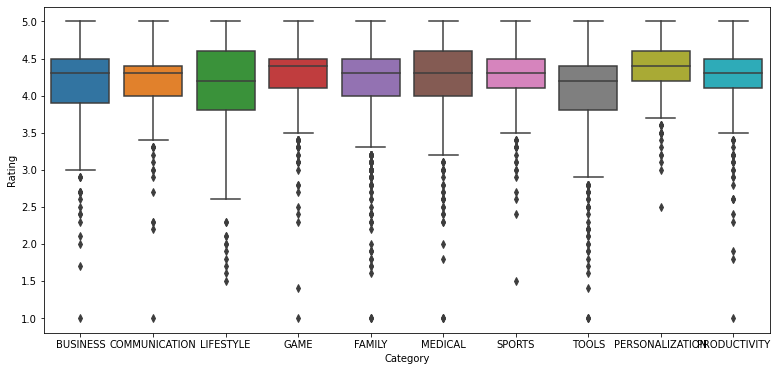

In [213]:
# 3. Рейтинг приложений для топ-5 категорий
top_categories = apps.Category.value_counts().sort_values(ascending = False).head(10).index.values
top_categories
sns.boxplot(x="Category", y="Rating", data=df[df.Category.isin(top_categories)])
# Вывод: Стабильног высокие рейтинги показывают категории Communication, Game, Sports, Personalization. В данных большие выбросы, необходимо с ними разбираться.

<AxesSubplot:xlabel='Genres', ylabel='Category'>

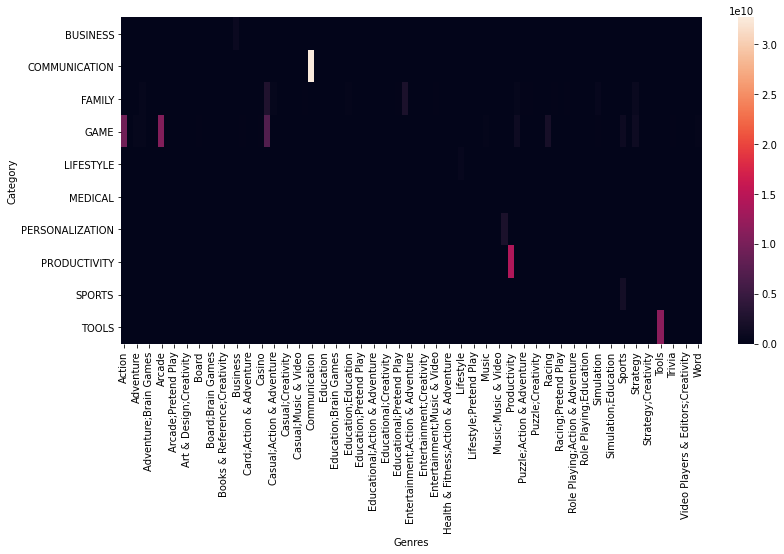

In [214]:
# 4. Суммарные установки по жанрам и категориям
platform_genre_installs = apps[apps.Category.isin(top_platforms)].pivot_table(
                        index='Category', 
                        columns='Genres', 
                        values='Installs', 
                        aggfunc=sum).fillna(0)

sns.heatmap(platform_genre_installs)
# Вывод: Больше всего установок у приложений в жанре и одноимённой категории Communication. Так же неплохо с играми, с продуктовыми и с приложениями из категории Tools.

In [215]:
platform_genre_installs

Genres,Action,Action;Action & Adventure,Adventure,Adventure;Action & Adventure,Adventure;Brain Games,Adventure;Education,Arcade,Arcade;Action & Adventure,Arcade;Pretend Play,Art & Design;Action & Adventure,...,Strategy;Action & Adventure,Strategy;Creativity,Strategy;Education,Tools,Tools;Education,Trivia,Trivia;Education,Video Players & Editors;Creativity,Video Players & Editors;Music & Video,Word
Category,,,,,,,,,,,,,,,,,,,,,
BUSINESS,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0
COMMUNICATION,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0
FAMILY,0.000000e+00,63020500.0,0.0,406150000.0,100000.0,20000000.0,0.000000e+00,65210001.0,1000000.0,100000.0,...,1100000.0,1000000.0,500000.0,0.000000e+00,0.0,0.0,100.0,5000000.0,15000000.0,0.0
GAME,9.342039e+09,25000000.0,406695320.0,500000000.0,0.0,0.0,1.072713e+10,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000e+00,0.0,128606370.0,0.0,0.0,0.0,269172550.0
LIFESTYLE,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0
MEDICAL,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0
PERSONALIZATION,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0
PRODUCTIVITY,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0
SPORTS,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0


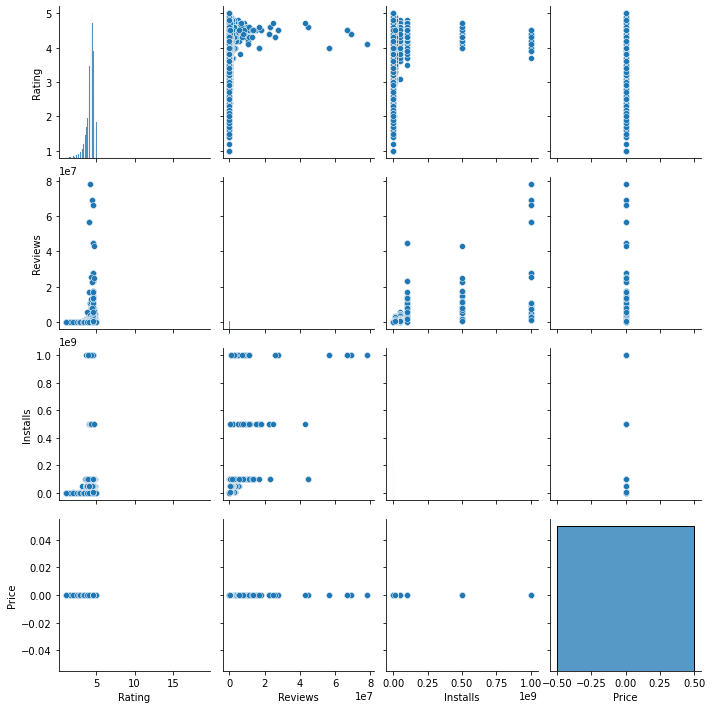

In [216]:
# 5. pair plot (scatter plot matrix). Посмотрим как связаны между собой различные признаки
sns.pairplot(apps[['Rating', 'Reviews', 'Installs', 'Price']])
# Вывод: Столбец цена не рассматриваем, везде нулевые значения. 
# Ревью производилось не по всем данным установок, скорее всего была выборка из примерно трёх количеств установок.
# Больше ревью проходят приложения с большими рейтингами

<AxesSubplot:title={'center':'Rating distribution'}>

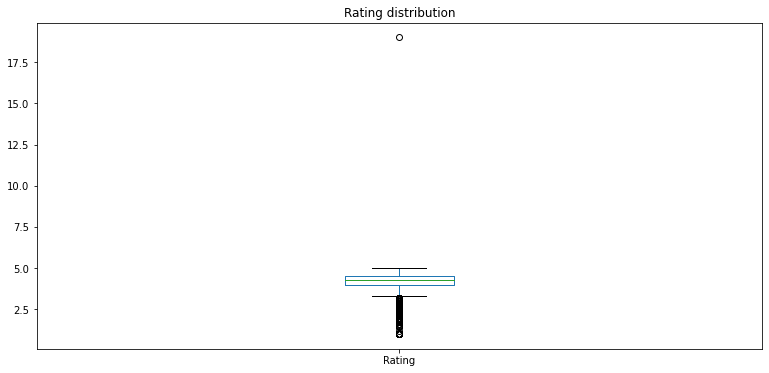

In [217]:
# 6. Распределение рейтингов
apps.Rating.plot(kind='box', title='Rating distribution')
# Есть выбросы, основное распределение между границами с 3 до 5

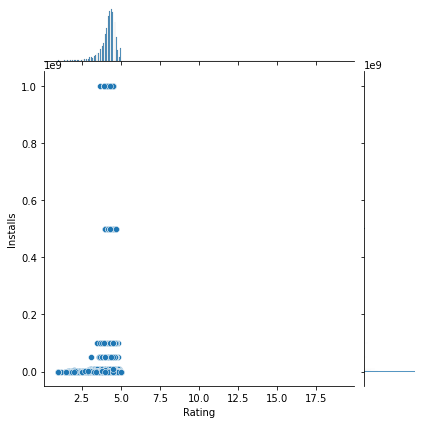

In [221]:
# 7. Взаимосвязь рейтингов и установок
sns.jointplot(x='Rating', y='Installs', data=apps, kind='scatter')
# Для выставления рейтингов выбирались приложения с определённым кол-вом установок

### Дополнительная часть (необязательная)

* построить дополнительно не менее 2 визуализаций (итого не менее 6);
* в работе должны присутствовать следующие визуализации: boxplot, heatmap, scatter plot matrix;


#### ПРИМЕЧАНИЕ
Домашнее задание сдается ссылкой на репозиторий [GitHub](https://github.com/).
Не сможем проверить или помочь, если вы пришлете:
- файлы;
- архивы;
- скриншоты кода.

Все обсуждения и консультации по выполнению домашнего задания ведутся только на соответствующем канале в slack.

##### Как правильно задавать вопросы аспирантам, преподавателям и коллегам
Прежде чем задать вопрос, попробуйте найти ответ в интернете. Навык самостоятельного поиска информации — один из важнейших. Каждый практикующий специалист любого уровня делает это ежедневно.

Сформулируйте вопрос по алгоритму:  
1) Что я делаю?  
2) Какого результата я ожидаю?  
3) Как фактический результат отличается от ожидаемого?  
4) Что я уже попробовал сделать, чтобы исправить проблему?  

По возможности прикрепите к вопросу скриншоты либо ссылки на код. Не выкладывайте все решение, оставляйте только проблемный и воспроизводимый участок кода.